### IMPORTS

In [2]:
import torch
torch.manual_seed(0)
import numpy as np
import matplotlib.pyplot as plt
import torchvision.models as models
from torchvision import transforms
from IPython.display import display
import PIL
from PIL import ImageFilter
from PIL import Image
# import urllib3 as urllib
import io

ModuleNotFoundError: No module named 'urllib3'

### IMAGENET UTILS

In [ ]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])
def preprocess_image(image):
    image = (image - mean) / std
    image = np.expand_dims(image, axis=0).transpose(0,3,1,2)
    return torch.Tensor(image)

def deprocess_image(tensor):
    tensor = ((tensor * std) + mean)
    tensor = np.uint8(tensor * 255.0)
    return PIL.Image.fromarray(tensor)

### TEST IMAGE

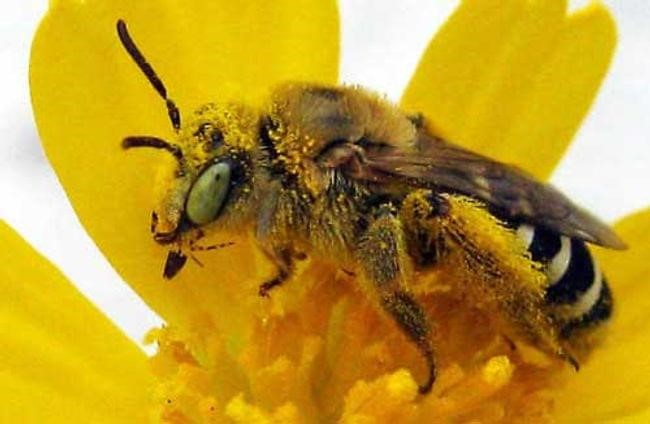

In [ ]:
TEST_IMAGE = PIL.Image.open("inputimage/bee1.jpg")
display(TEST_IMAGE)
preprocessed_image = preprocess_image(np.asarray(TEST_IMAGE)/255.0)

### MODEL and INFERENCE

In [ ]:
model = models.resnet50(pretrained=True)
model.cuda()
model.eval()
yhat = model(preprocessed_image.clone().detach().cuda().requires_grad_(True))
probabilities = torch.nn.functional.softmax(yhat[0], dim=0)

with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]
# Show top categories per image
top5_prob, top5_catid = torch.topk(probabilities, 5)
for i in range(top5_prob.size(0)):
    cat_name = categories[top5_catid[i]]
    cat_name = cat_name[1+cat_name.find(':'):]
    print(cat_name, top5_prob[i].item())


 'bee', 0.6431998610496521
 'fly', 0.018821924924850464
 'isopod', 0.01793857477605343
 'ant, emmet, pismire', 0.0170980766415596
 'honeycomb', 0.017004823312163353


### ACTIVATIONS

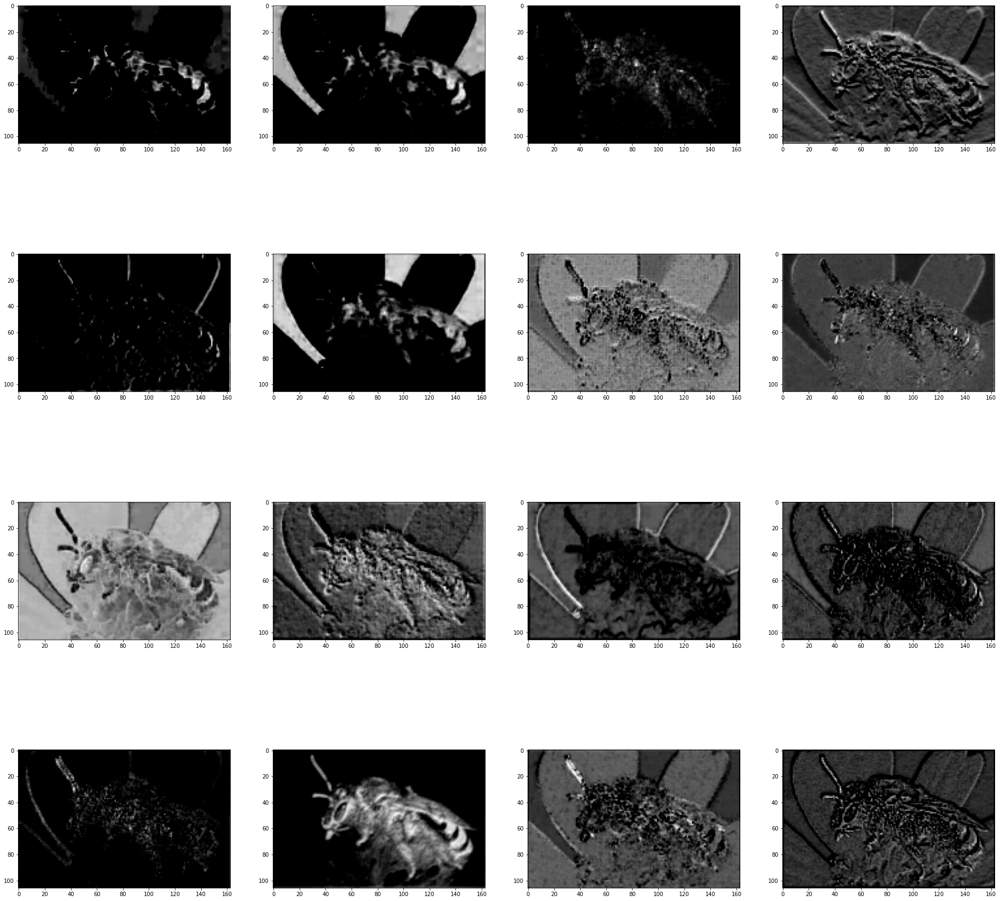

In [ ]:
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

def showActivations(layerName):
    k=0
    act = activation[layerName].squeeze()
    fig, axarr = plt.subplots(4,4,figsize=(32, 32))
    k=0
    for i in range(4):
        for j in range(4):
            axarr[i,j].imshow(act[k].detach().cpu().numpy(), cmap='gray')
            k+=1  
            
model.layer1[0].register_forward_hook(get_activation('conv0'))
data = preprocessed_image.clone().detach().cuda().requires_grad_(True)
data=data.to('cuda')
output = model(data)
showActivations('conv0')





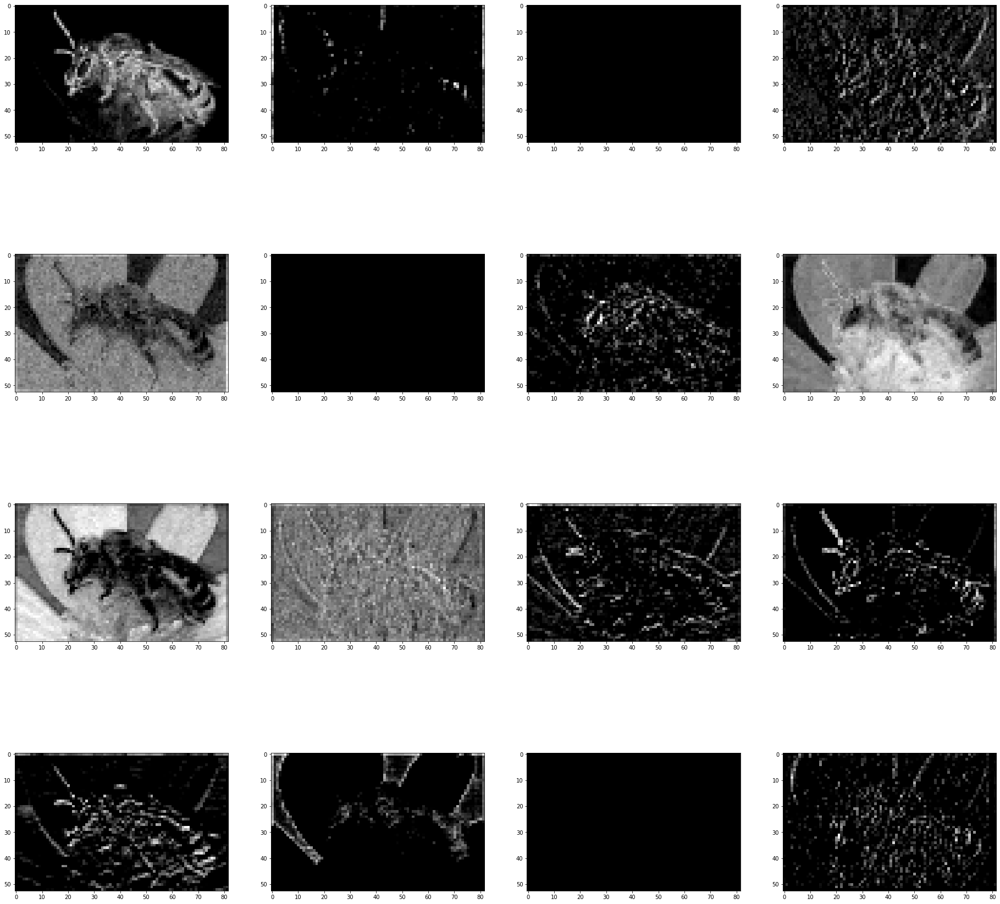

In [ ]:
model.layer2[0].register_forward_hook(get_activation('conv2'))
data = preprocessed_image.clone().detach().cuda().requires_grad_(True)
data=data.to('cuda')
output = model(data)
showActivations('conv2')

### FILTER MAX

In [ ]:
class ActivationsExtractor():    
    def __init__(self, module):
        self.hook = module.register_forward_hook(self.hook_fn)
        
    def hook_fn(self, module, input, output):
        self.features = output

    def close(self):
        self.hook.remove()

In [ ]:
# layer = list(model.layer4[2].children())[6] # last non-output layer
# activations = ActivationsExtractor(layer) # activations' hook
# _ = model(preprocessed_image.cuda()) # forward pass to collect activations
# average_activations_per_filters = [activations.features[0, i].mean().item() for i in range(activations.features.shape[1])]

In [ ]:
# fig = plt.plot(average_activations_per_filters)
# ax = fig[0].axes
# ax.set_xlabel("filter")
# ax.set_ylabel("average activation")
# plt.show()

# probs = torch.tensor(average_activations_per_filters)
# values, idx = torch.topk(probs, k=3, axis=-1)
# # most_activated_filter_idx = np.argmax(average_activations_per_filters, axis=0)
# # print(idx)

In [ ]:
def visualizeFilter(activations, filter, lr, steps, size, upscales, upscale_factor):
    img = np.uint8(np.random.uniform(150, 180, (size, size, 3)))/255    

    for _ in range(upscales):                        
        img_var = preprocess_image(img).clone().detach().cuda().requires_grad_(True)
        optimizer = torch.optim.Adam([img_var], lr=lr, weight_decay=1e-6)

        for _ in range(steps):
            optimizer.zero_grad()
            model(img_var)
            loss = -activations.features[0, filter].mean()
            loss.backward()
            optimizer.step()

        img = deprocess_image(img_var.data.cpu().numpy()[0].transpose(1,2,0))
        output = img
        size = int(upscale_factor * size) 
        img = img.resize((size, size)) 
        img = img.filter(ImageFilter.BLUR)
        img = np.asarray(img) / 255.0
    display(output)

def getMainFilters(layer, k):
    activations = ActivationsExtractor(layer) # activations' hook
    _ = model(preprocessed_image.cuda()) # forward pass to collect activations
    average_activations_per_filters = [activations.features[0, i].mean().item() for i in range(activations.features.shape[1])]
    probs = torch.tensor(average_activations_per_filters)
    _ , idx = torch.topk(probs, k=k, axis=-1)
    return idx,activations


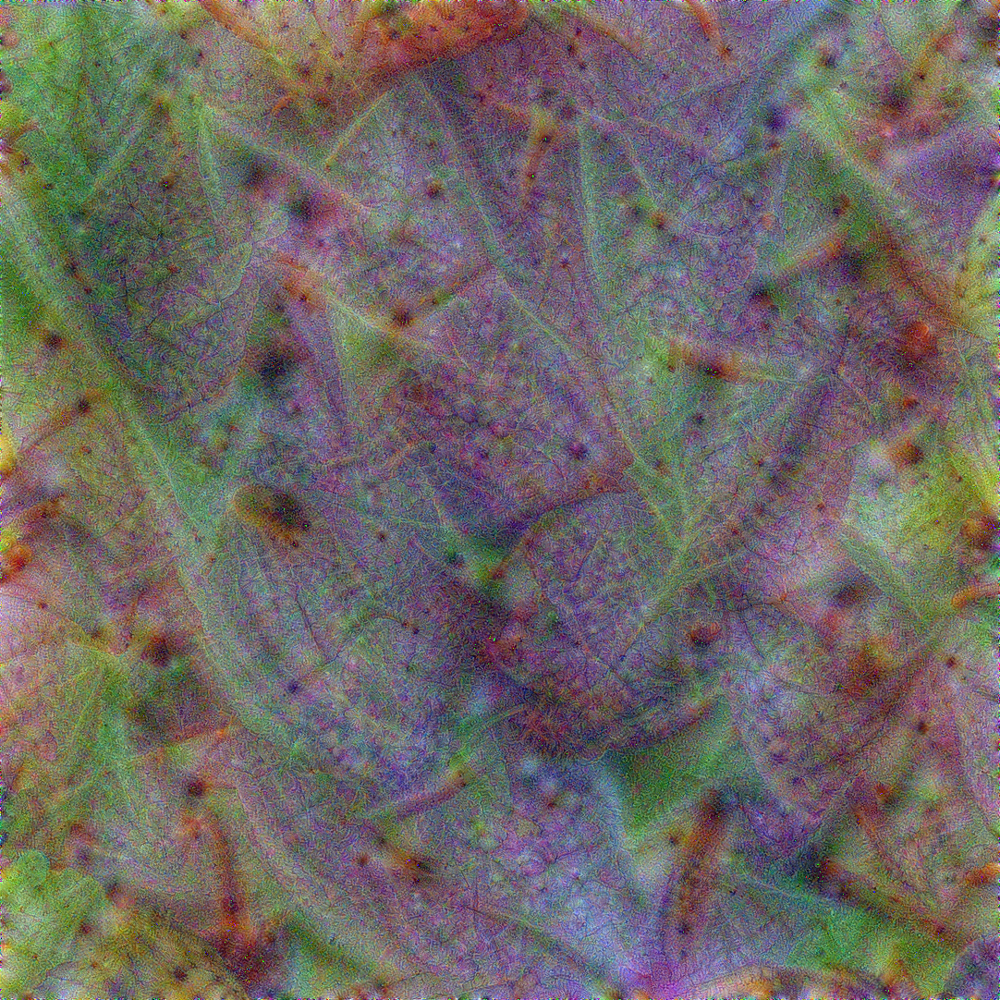

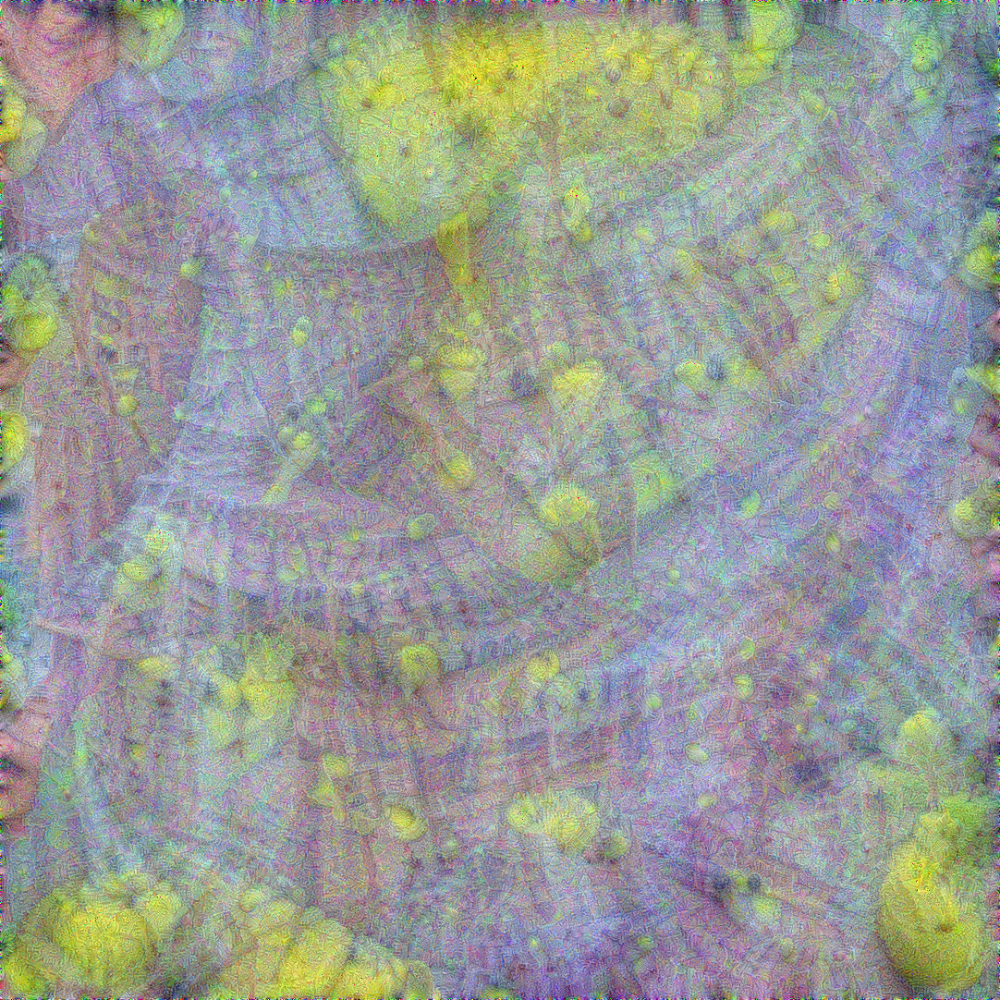

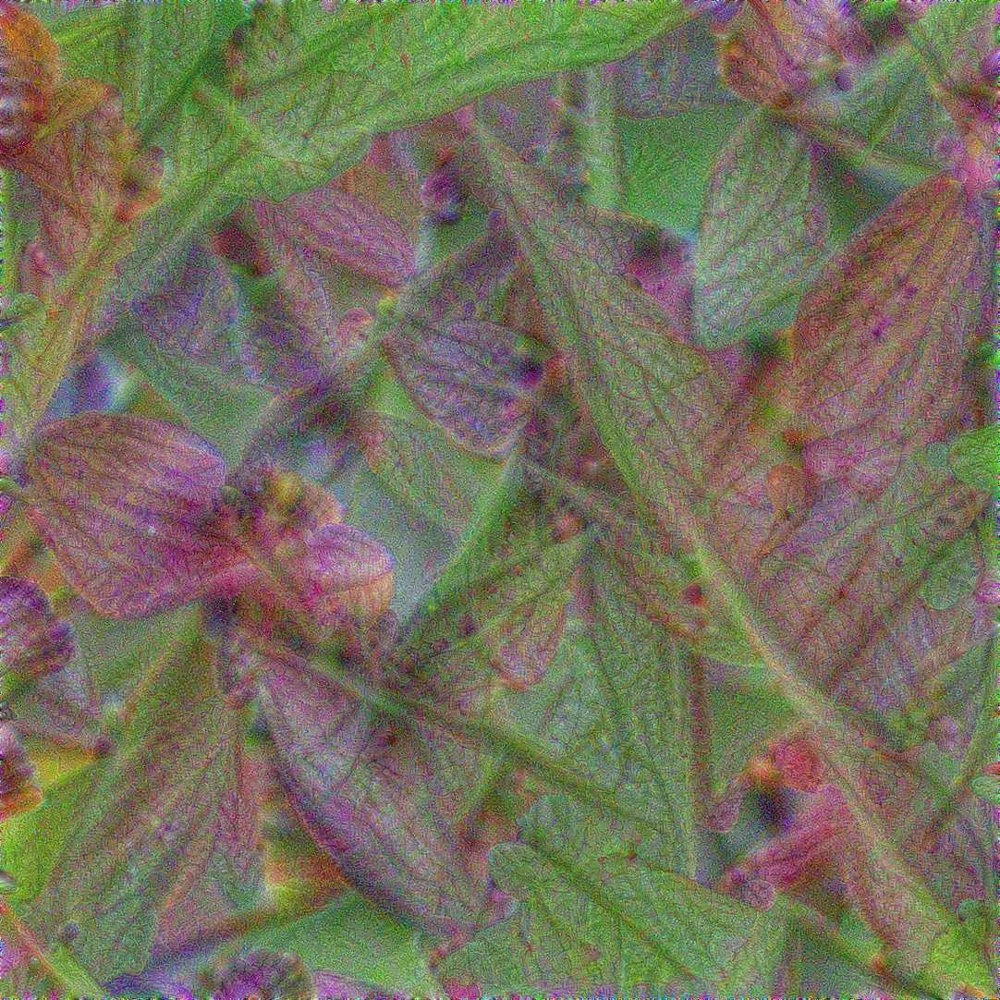

In [ ]:
l = list(model.layer4[2].children())[6] # last non-output layer
filterList, activationList = getMainFilters(l, 3)
for f in filterList:
    visualizeFilter(activationList,
                f,
                lr=0.075,
                size=36,
                steps=15,
                upscales=20,
                upscale_factor=1.2)

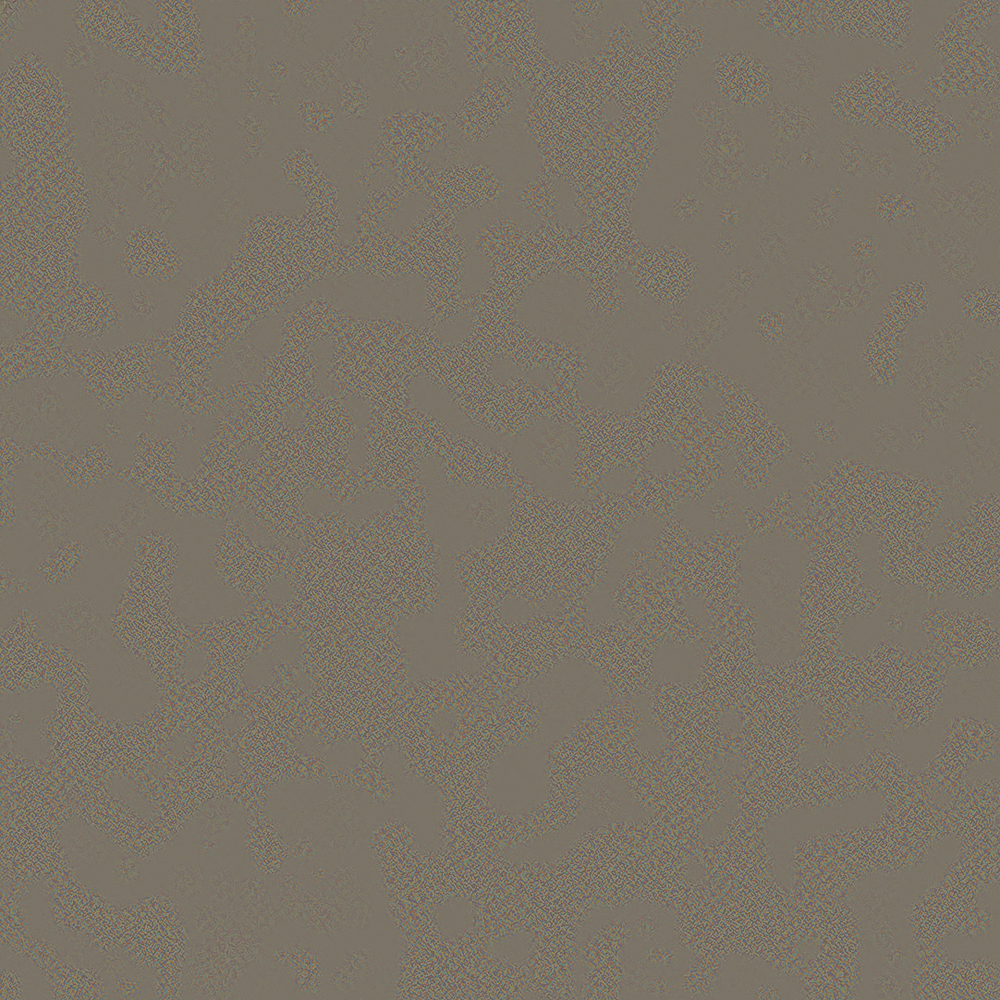

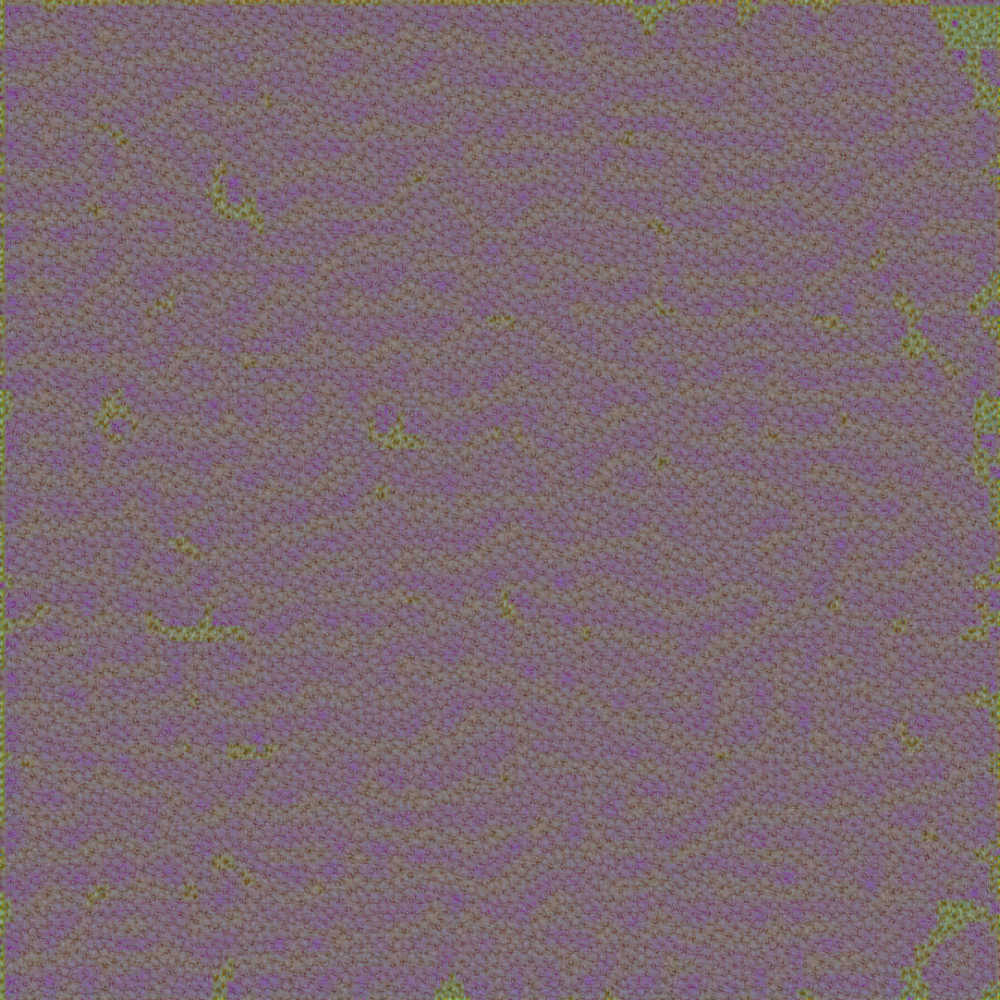

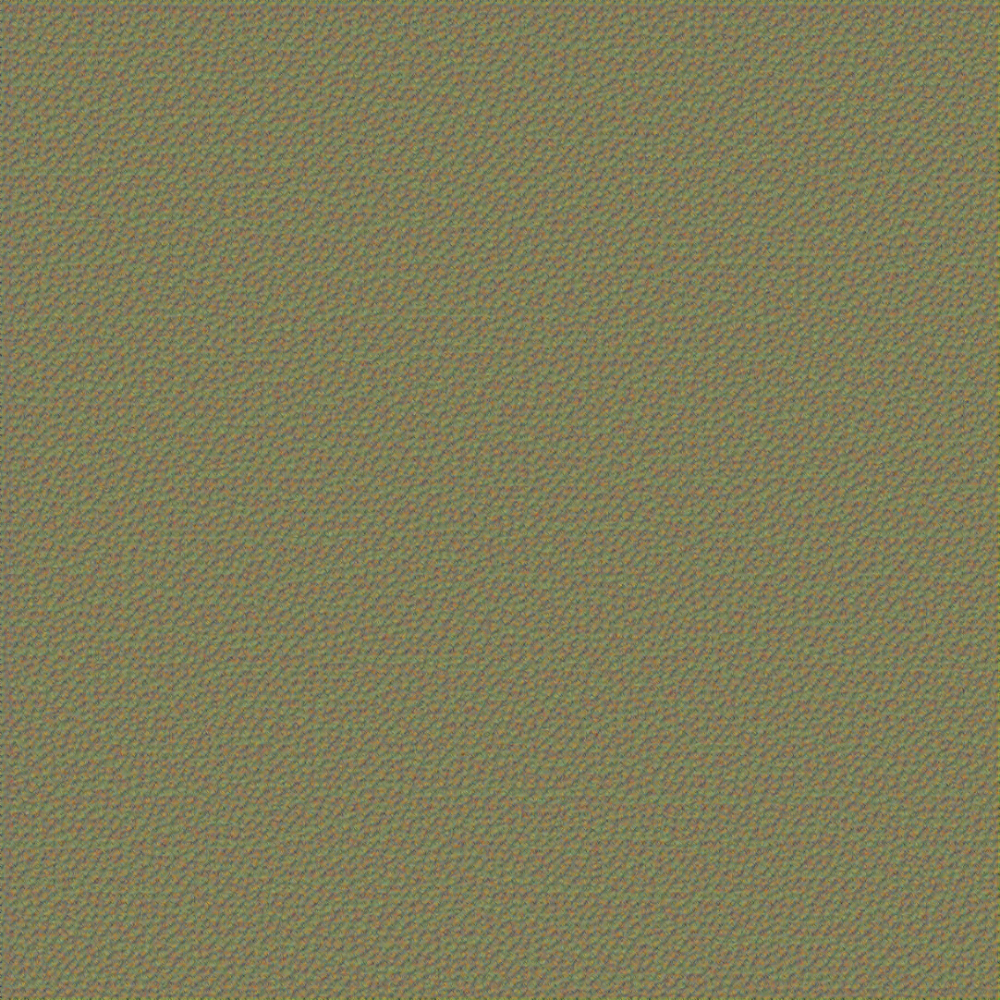

In [ ]:
l = list(model.layer2[1].children())[6] # last non-output layer
filterList, activationList = getMainFilters(l, 3)
for f in filterList:
    visualizeFilter(activationList,
                f,
                lr=0.075,
                size=36,
                steps=15,
                upscales=20,
                upscale_factor=1.2)